
# KNN Probing Plots

This notebook reads the KNN probing metrics from the TSV file and creates plots
showing how different metrics vary with k for different representation types,
split strategies, and endpoints.


In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from pathlib import Path

# Set style
sns.set_style("whitegrid")
plt.rcParams['figure.figsize'] = (12, 8)


In [2]:
# Configuration: Set which k values to plot
# Options: 'all', 'even', 'odd'
K_FILTER = 'all'  # Change this to 'even' or 'odd' to filter k values

# Set to True to normalize all y-axes to 0-1 range, False for data-driven ranges
NORMALIZE_Y_AXIS = True

output_dir = Path("data") / "final_data" / "knn_probing_plots"
output_dir.mkdir(exist_ok=True)

In [3]:
# Load the data
df = pd.read_csv(Path("data") / "intermediate_data" / "knn_probing_metrics.tsv", sep="\t")
df

,Unnamed: 0,k,sensitivity,specificity,roc_auc,pr_auc,balanced_accuracy,precision,f1,endpoint,split_strategy,representation_type,fold,num_ties
0,0,1.0,0.470588,0.771930,0.621259,0.511336,0.621259,0.606061,0.529801,APR_HepG2_CellLoss_72h_dn,Random,morgan_count,0,0
1,1,2.0,0.470588,0.771930,0.677761,0.608750,0.621259,0.606061,0.529801,APR_HepG2_CellLoss_72h_dn,Random,morgan_count,0,2
2,2,3.0,0.470588,0.842105,0.693550,0.664066,0.656347,0.689655,0.559441,APR_HepG2_CellLoss_72h_dn,Random,morgan_count,0,0
3,3,4.0,0.458824,0.842105,0.685088,0.655492,0.650464,0.684211,0.549296,APR_HepG2_CellLoss_72h_dn,Random,morgan_count,0,0
4,4,5.0,0.400000,0.824561,0.674665,0.633482,0.612281,0.629630,0.489209,APR_HepG2_CellLoss_72h_dn,Random,morgan_count,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
279995,195,196.0,0.507937,0.918245,0.796895,0.483359,0.713091,0.438356,0.470588,nr_er,Agglomerative clustering,chemeleon,4,0
279996,196,197.0,0.507937,0.919242,0.797896,0.483378,0.713589,0.441379,0.472325,nr_er,Agglomerative clustering,chemeleon,4,0
279997,197,198.0,0.507937,0.920239,0.798042,0.486294,0.714088,0.444444,0.474074,nr_er,Agglomerative clustering,chemeleon,4,0
279998,198,199.0,0.507937,0.921236,0.798256,0.486912,0.714586,0.447552,0.475836,nr_er,Agglomerative clustering,chemeleon,4,0


In [4]:
# Explore the data
print(f"Unique endpoints: {df['endpoint'].nunique()}")
print(f"Endpoints: {df['endpoint'].unique()}")
print(f"\nUnique split strategies: {df['split_strategy'].unique()}")
print(f"Unique representation types: {df['representation_type'].unique()}")
print(f"Unique k values: {sorted(df['k'].unique())}")
print(f"Unique folds: {sorted(df['fold'].unique())}")


Unique endpoints: 20
Endpoints: ['APR_HepG2_CellLoss_72h_dn' 'ATG_NRF2_ARE_CIS_up' 'ATG_PXRE_CIS_up'
 'BSK_3C_HLADR_down' 'BSK_3C_Proliferation_down' 'BSK_3C_SRB_down'
 'BSK_3C_Vis_down' 'BSK_4H_Eotaxin3_down' 'BSK_CASM3C_Proliferation_down'
 'BSK_LPS_VCAM1_down' 'BSK_SAg_CD38_down' 'BSK_SAg_CD40_down'
 'BSK_SAg_Proliferation_down' 'BSK_hDFCGF_CollagenIII_down'
 'BSK_hDFCGF_Proliferation_down' 'CEETOX_H295R_11DCORT_dn'
 'CEETOX_H295R_ANDR_dn' 'TOX21_ARE_BLA_agonist_ratio'
 'TOX21_TR_LUC_GH3_Antagonist' 'nr_er']

Unique split strategies: ['Random' 'Agglomerative clustering']
Unique representation types: ['morgan_count' 'morgan' 'rdkit_physchem' 'mordred' 'chemprop'
 'chemeleon_no_pretraining' 'chemeleon']
Unique k values: [np.float64(1.0), np.float64(2.0), np.float64(3.0), np.float64(4.0), np.float64(5.0), np.float64(6.0), np.float64(7.0), np.float64(8.0), np.float64(9.0), np.float64(10.0), np.float64(11.0), np.float64(12.0), np.float64(13.0), np.float64(14.0), np.float64(15.0), np.floa

In [5]:
# Define metrics to plot
metrics = ['sensitivity', 'specificity', 'roc_auc', 'balanced_accuracy', 'pr_auc', 'f1']

# Get unique values for grouping
endpoints = sorted(df['endpoint'].unique())
split_strategies = sorted(df['split_strategy'].unique())
representation_types = sorted(df['representation_type'].unique())

rep_type_config = {
    'chemeleon': {
        'color': '#ff0000',        # Bright red
        'linestyle': '-',          # Solid line
        'marker': None,            # No marker
        'linewidth': 2.5,          # Line width for regular plots
        'linewidth_pub': 1.0,      # Line width for publication figure
        'alpha': 0.2,              # Alpha for std shading (regular)
        'alpha_pub': 0.15,         # Alpha for std shading (publication)
        'zorder': 5,               # Plot order (higher = on top)
    },
    'chemprop': {
        'color': '#0000ff',        # Bright blue
        'linestyle': '-',
        'marker': None,
        'linewidth': 2.5,
        'linewidth_pub': 1.0,
        'alpha': 0.2,
        'alpha_pub': 0.15,
        'zorder': 5,
    },
    'rdkit_physchem': {
        'color': '#00ff00',        # Bright green
        'linestyle': '-',
        'marker': None,
        'linewidth': 2.5,
        'linewidth_pub': 1.0,
        'alpha': 0.2,
        'alpha_pub': 0.15,
        'zorder': 5,
    },
    'morgan': {
        'color': '#ffa500',        # Bright orange
        'linestyle': '-',
        'marker': None,
        'linewidth': 2.5,
        'linewidth_pub': 1.0,
        'alpha': 0.2,
        'alpha_pub': 0.15,
        'zorder': 5,
    },
    'morgan_count': {
        'color': '#800080',        # Bright purple
        'linestyle': '-',
        'marker': None,
        'linewidth': 2.5,
        'linewidth_pub': 1.0,
        'alpha': 0.2,
        'alpha_pub': 0.15,
        'zorder': 5,
    },
    'mordred': {
        'color': '#000000',        # Black
        'linestyle': '-',
        'marker': None,
        'linewidth': 2.5,
        'linewidth_pub': 1.0,
        'alpha': 0.2,
        'alpha_pub': 0.15,
        'zorder': 5,
    },
    'chemeleon_no_pretraining': {
        'color': '#E11845',        # Pink/Red
        'linestyle': '--',         # Dashed line (to distinguish from regular chemeleon)
        'marker': None,
        'linewidth': 2.5,
        'linewidth_pub': 1.0,
        'alpha': 0.2,
        'alpha_pub': 0.15,
        'zorder': 10,              # Plot last (on top of others)
    },
}

# Helper function to get config with defaults
def get_rep_config(rep_type, key, default=None):
    """Get configuration value for a representation type with fallback to default."""
    if rep_type in rep_type_config:
        return rep_type_config[rep_type].get(key, default)
    return default

print(f"Will create plots for:")
print(f"  - {len(split_strategies)} split strategies")
print(f"  - {len(endpoints)} endpoints")
print(f"  - {len(metrics)} metrics")
print(f"  - {len(representation_types)} representation types")
print(f"\nConfigured representation types:")
for rep_type in sorted(rep_type_config.keys()):
    print(f"  - {rep_type}: {rep_type_config[rep_type]['color']} ({rep_type_config[rep_type]['linestyle']})")


Will create plots for:
  - 2 split strategies
  - 20 endpoints
  - 6 metrics
  - 7 representation types

Configured representation types:
  - chemeleon: #ff0000 (-)
  - chemeleon_no_pretraining: #E11845 (--)
  - chemprop: #0000ff (-)
  - mordred: #000000 (-)
  - morgan: #ffa500 (-)
  - morgan_count: #800080 (-)
  - rdkit_physchem: #00ff00 (-)


In [6]:
# Calculate global axis ranges for consistent plotting
k_min = df['k'].min()
k_max = df['k'].max()

# Calculate y-axis ranges based on configuration
metric_ranges = {}
if NORMALIZE_Y_AXIS:
    # Set all metrics to 0-1 range
    for metric in metrics:
        metric_ranges[metric] = (0, 1)

    print("Global axis ranges:")
    print(f"  k: {k_min} to {k_max}")
    print(f"  All metrics: 0.0000 to 1.0000 (normalized)")
else:
    # Use data-driven ranges with padding
    for metric in metrics:
        if df[metric].notna().any():
            metric_min = df[metric].min()
            metric_max = df[metric].max()
            # Add 5% padding
            padding = (metric_max - metric_min) * 0.05
            metric_ranges[metric] = (metric_min - padding, metric_max + padding)
        else:
            metric_ranges[metric] = (0, 1)  # Default range for empty data

    print("Global axis ranges:")
    print(f"  k: {k_min} to {k_max}")
    for metric, (y_min, y_max) in metric_ranges.items():
        print(f"  {metric}: {y_min:.4f} to {y_max:.4f} (data-driven)")


Global axis ranges:
  k: 1.0 to 200.0
  All metrics: 0.0000 to 1.0000 (normalized)


Saved: data/final_data/knn_probing_plots/Agglomerative_clustering_nr_er.png


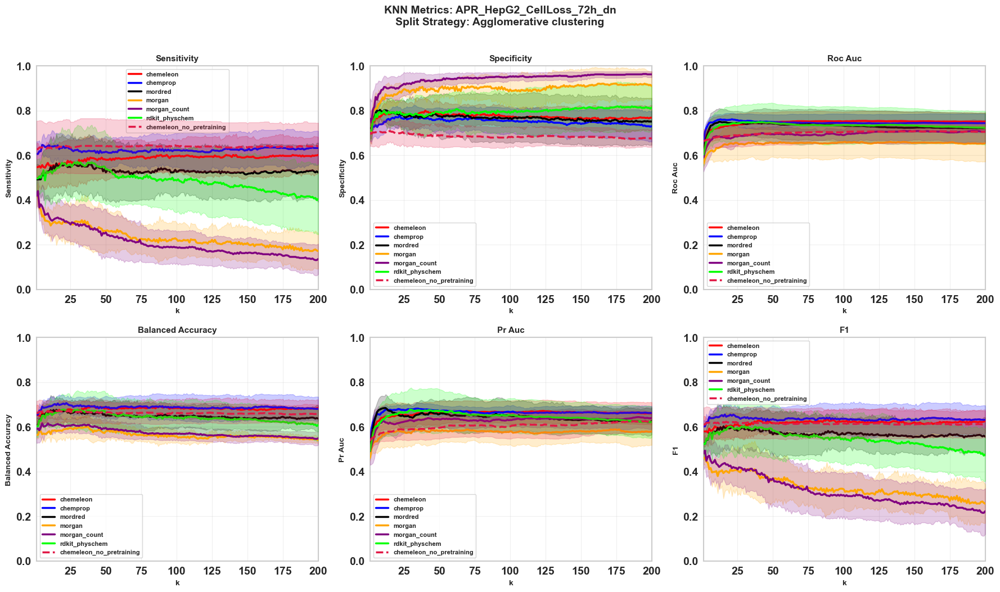

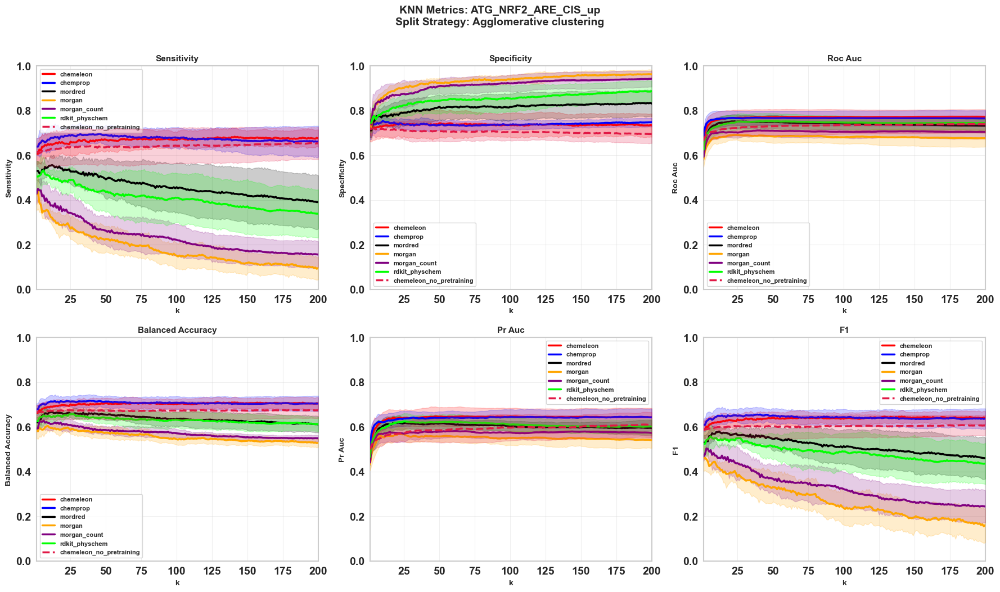

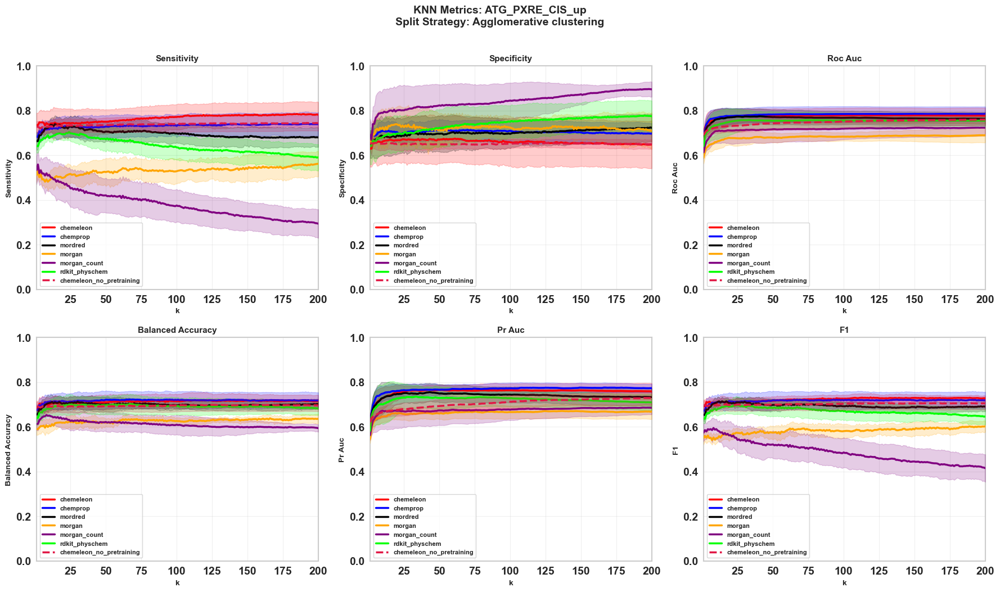

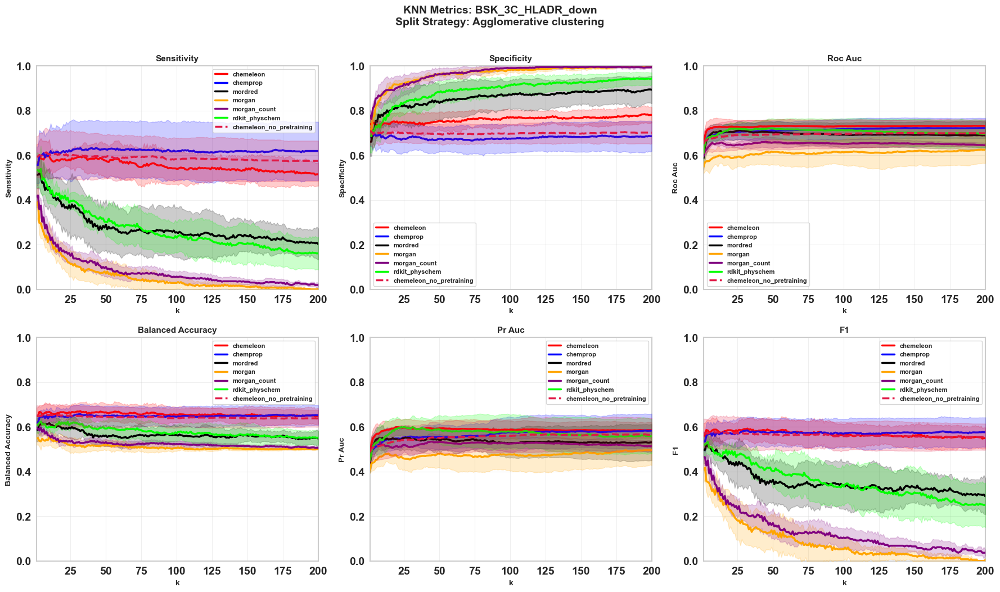

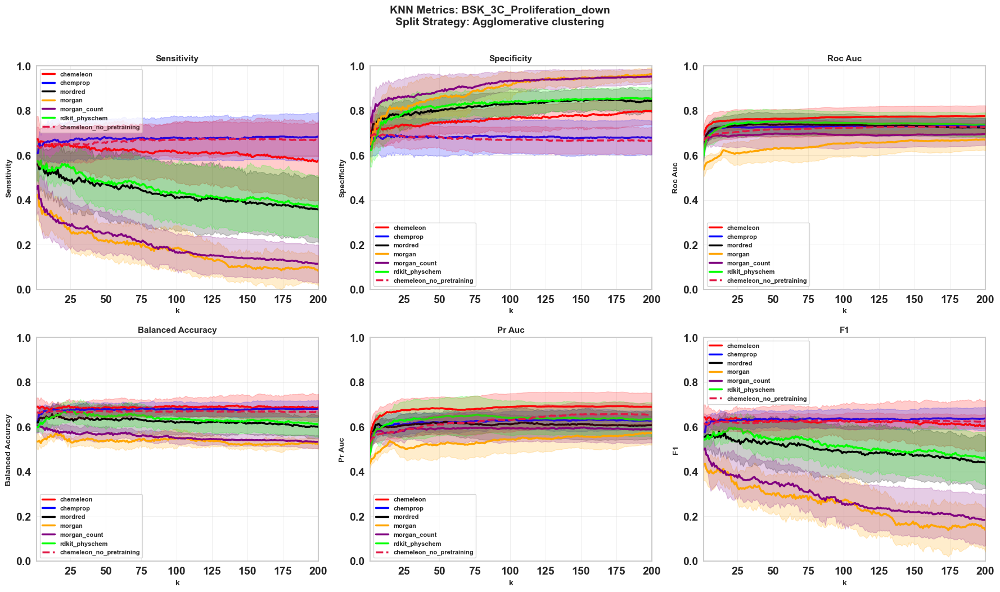

...

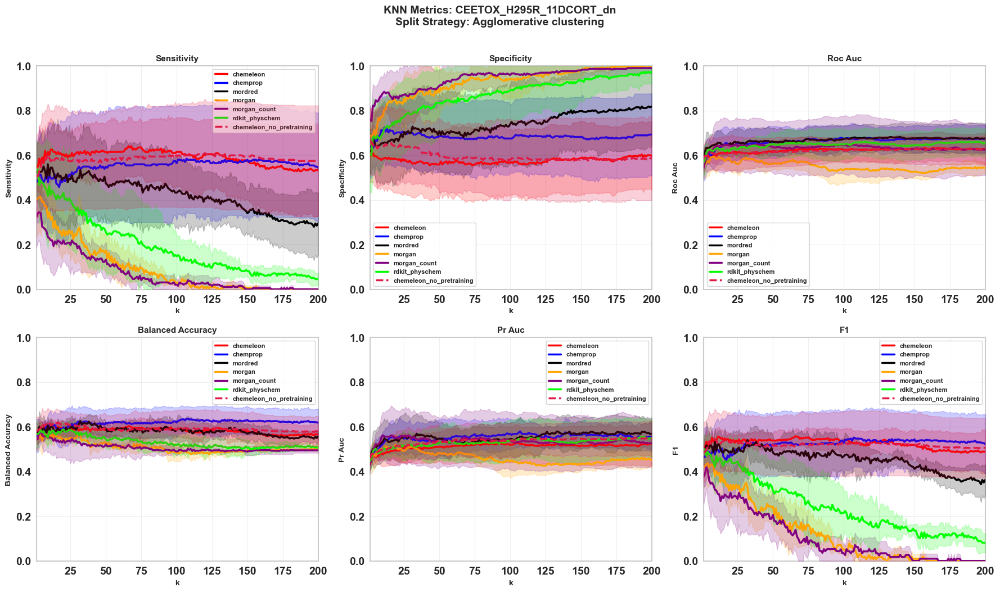

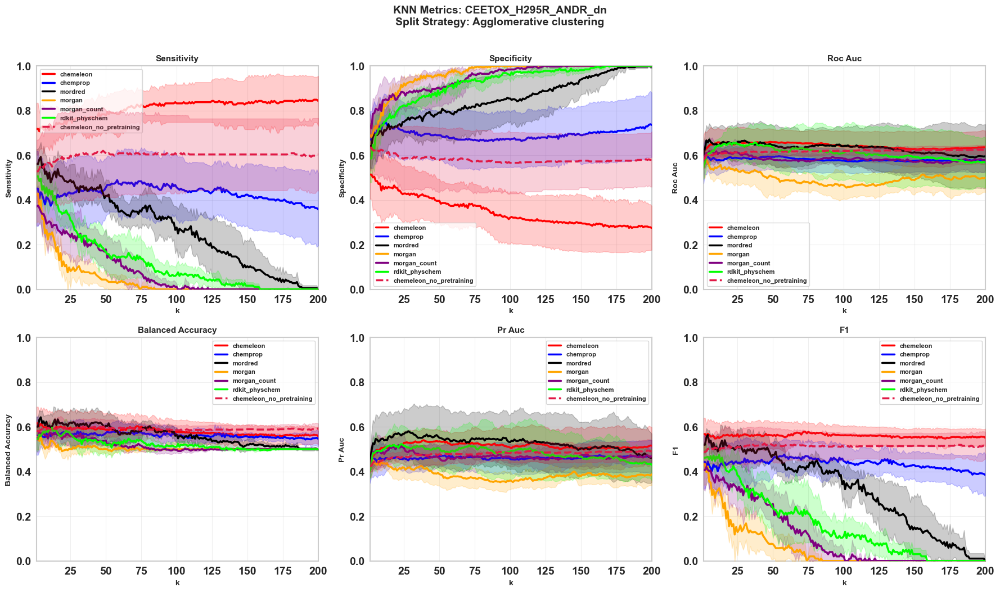

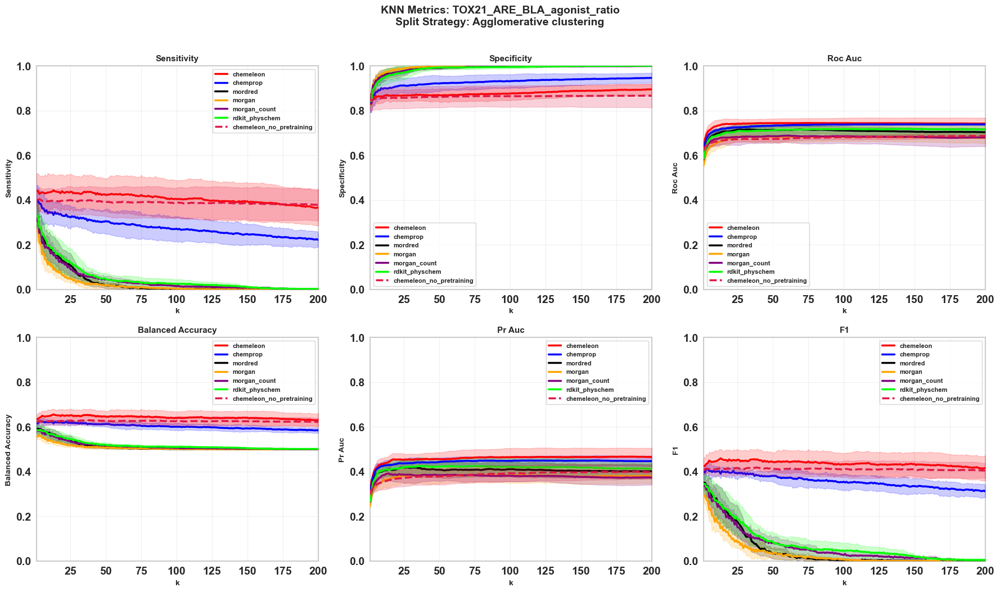

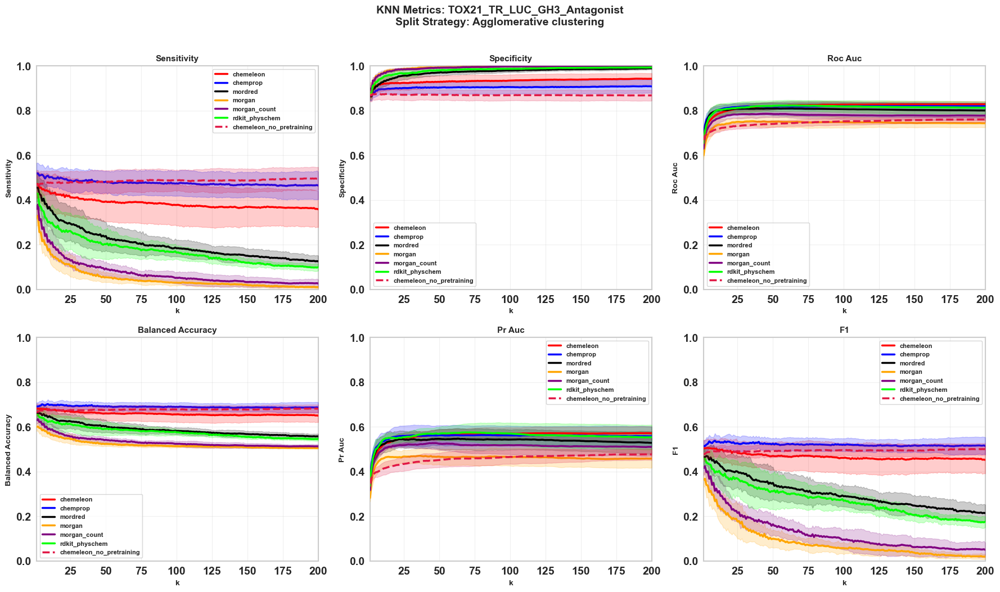

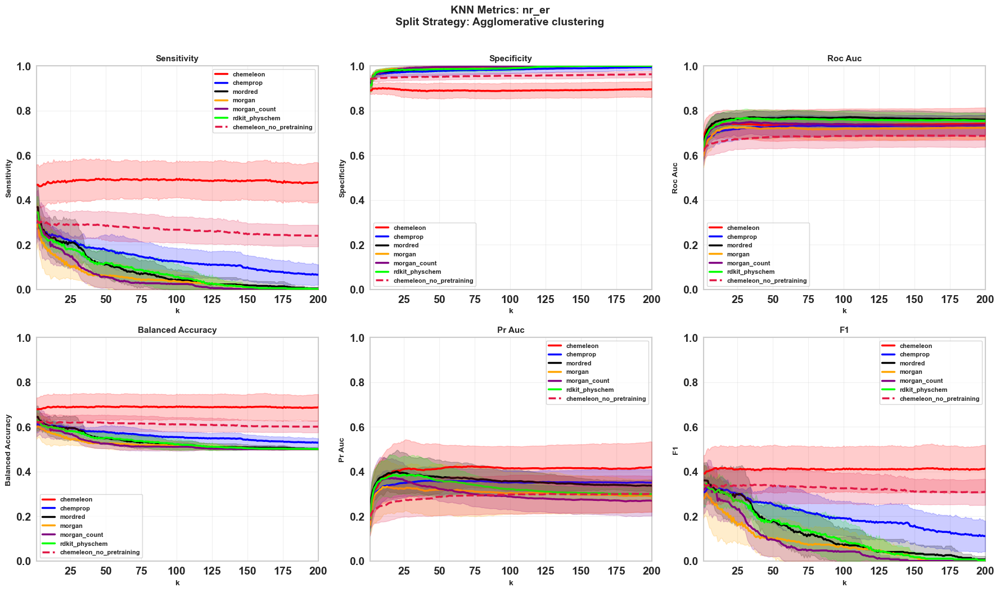

Saved: data/final_data/knn_probing_plots/Random_nr_er.png


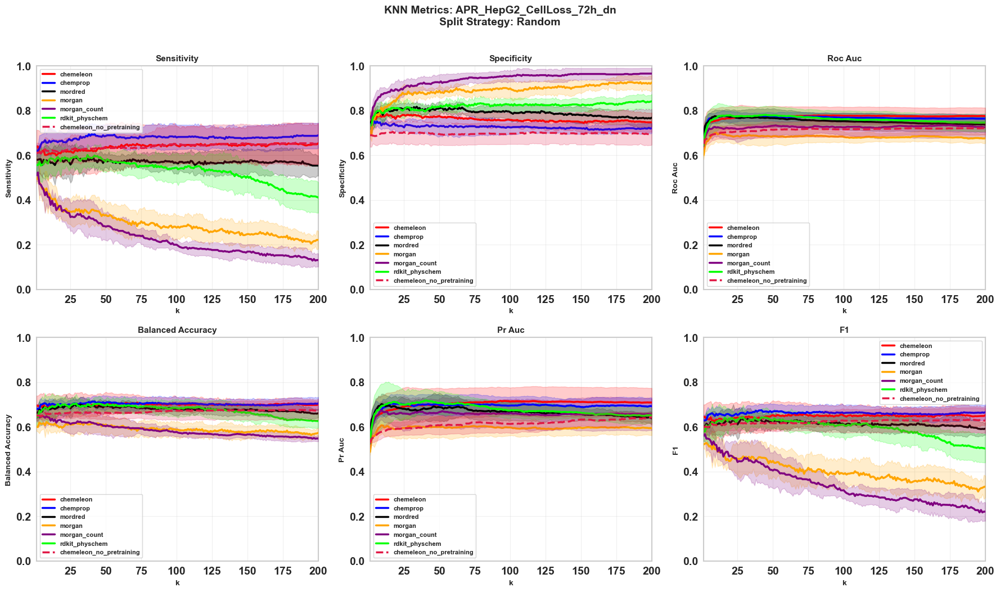

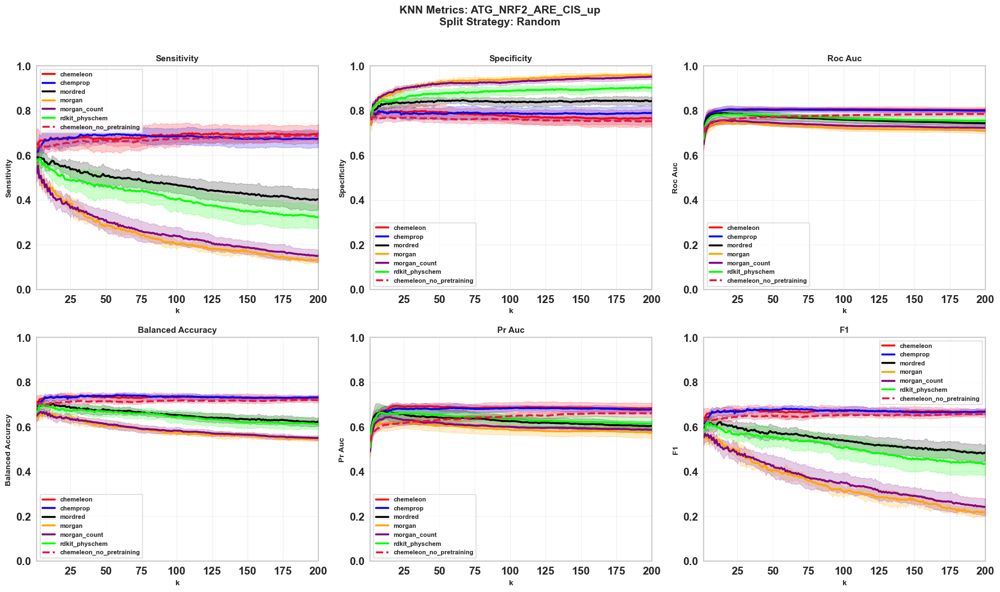

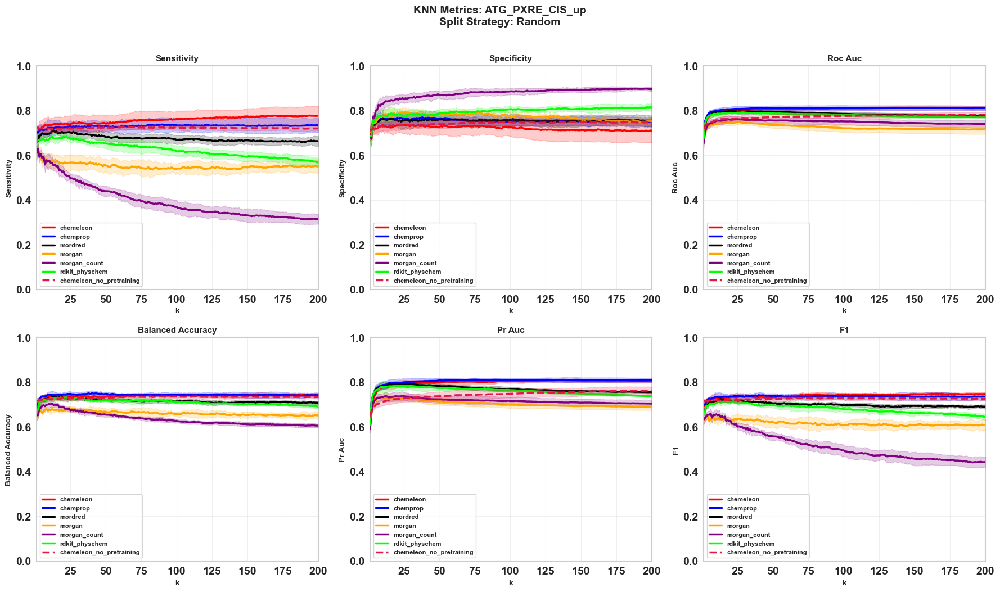

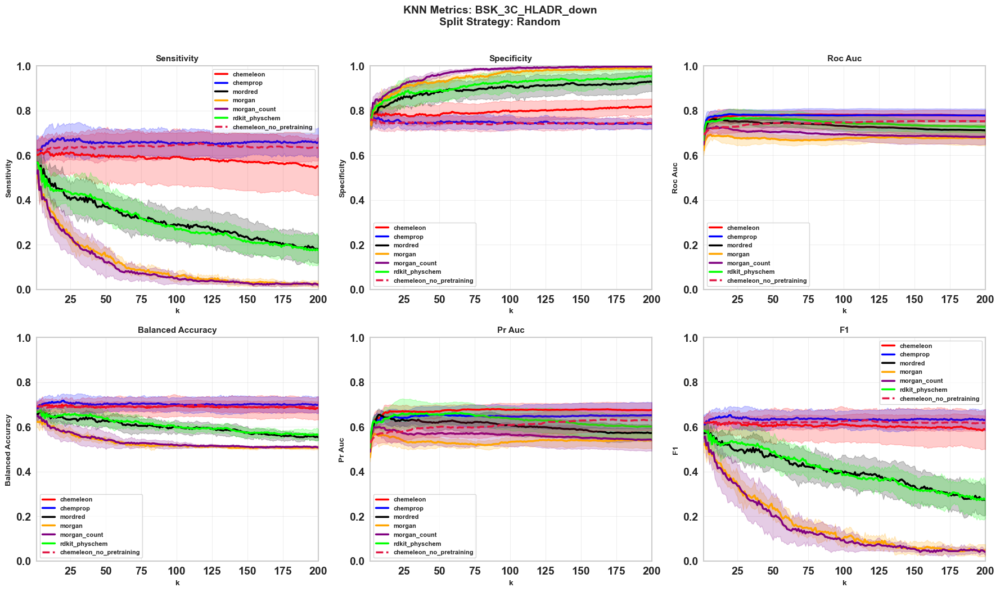

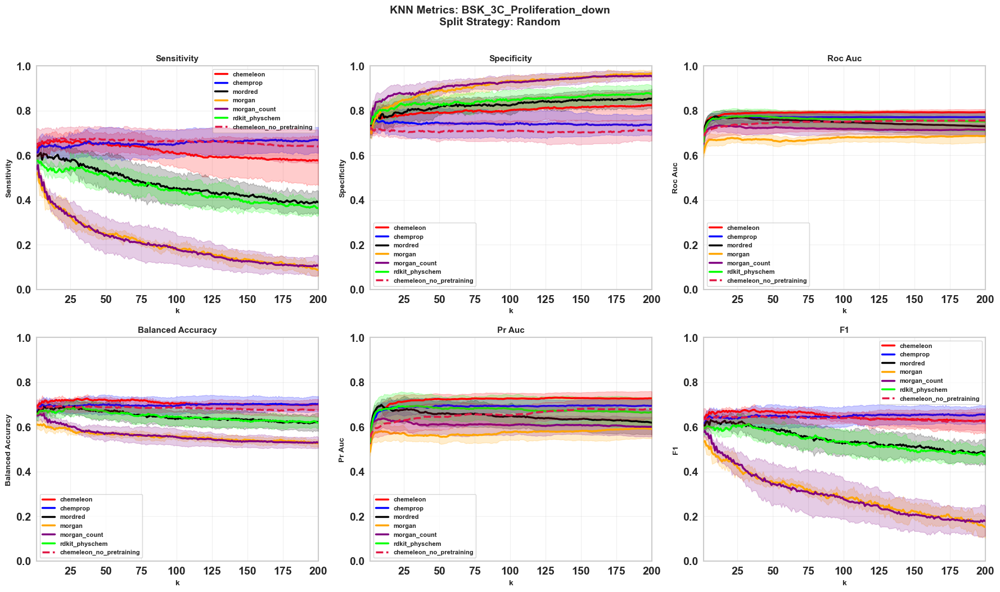

...

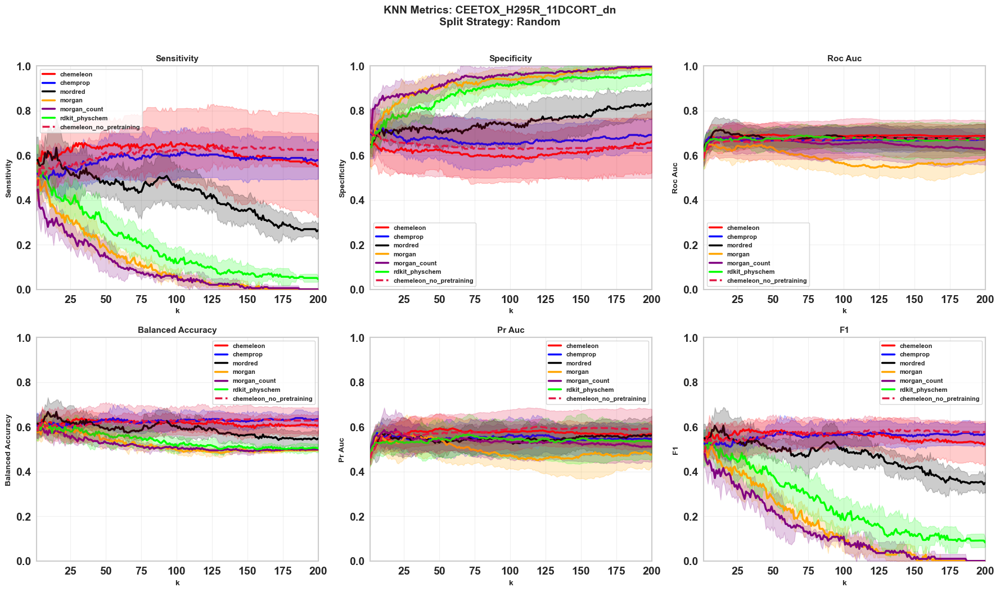

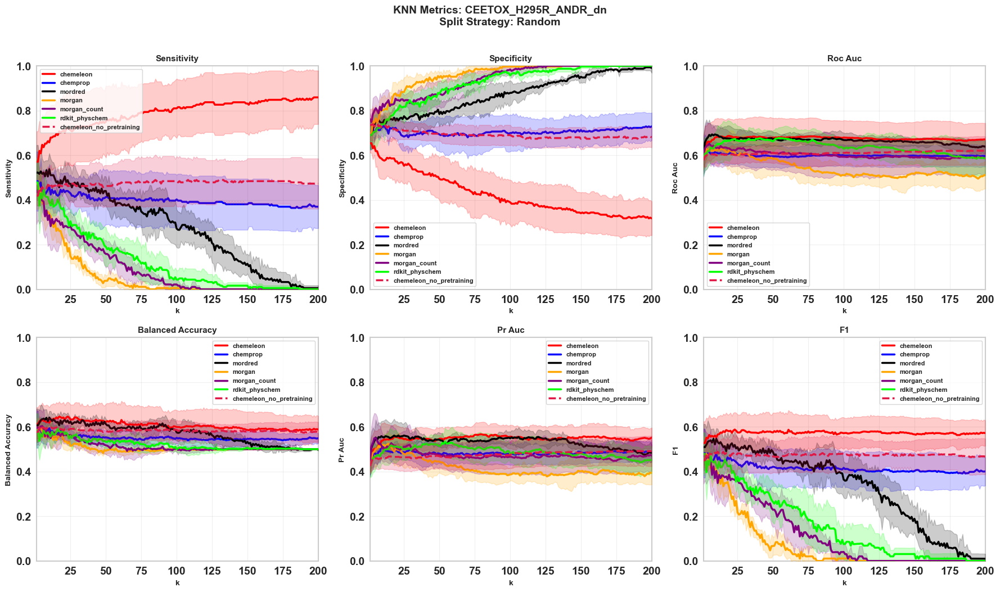

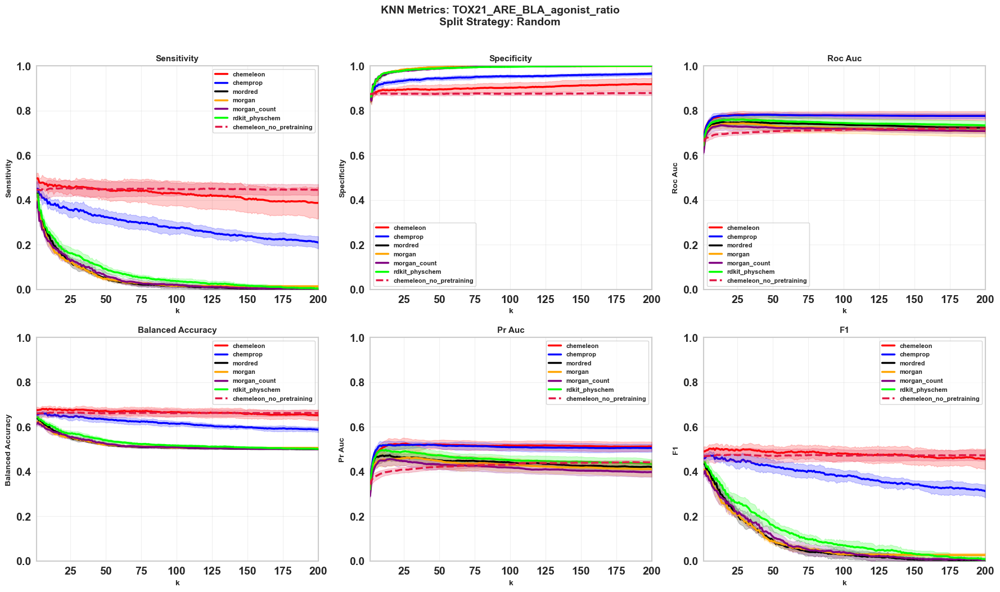

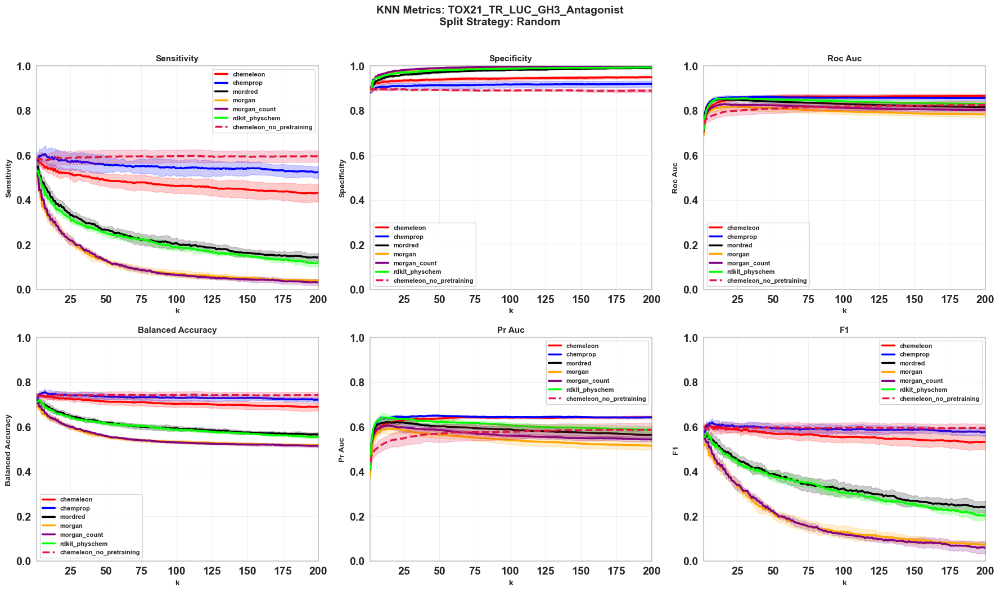

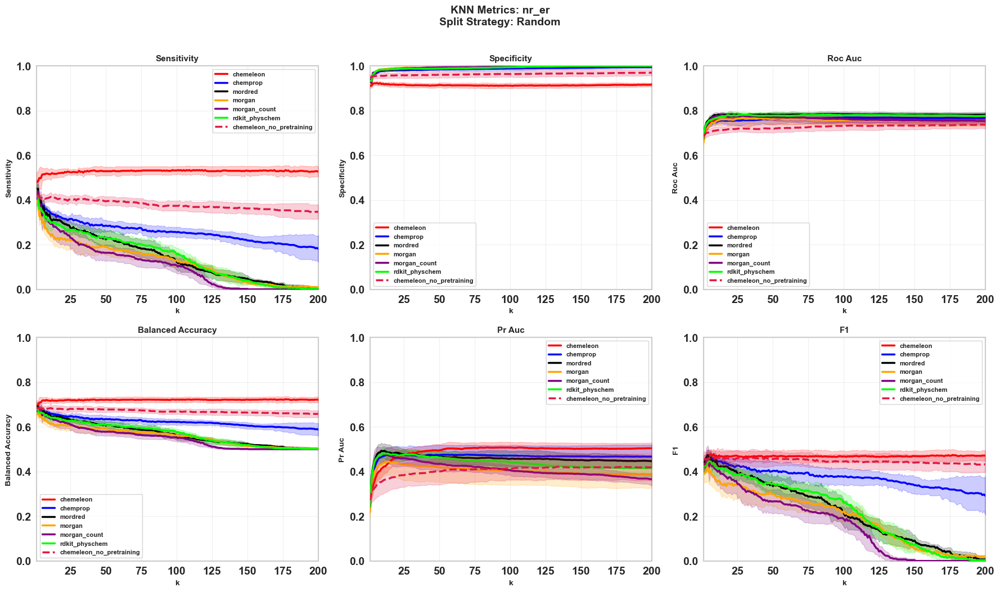


All summary plots saved to data/final_data/knn_probing_plots/


In [7]:
# Create plots for each combination of metric, endpoint, and split_strategy
# Each plot will have k on x-axis, metric on y-axis, and one line per representation_type

for split_strategy in split_strategies:
    for endpoint in endpoints:
        # Create a figure with subplots for each metric
        fig, axes = plt.subplots(3, 3, figsize=(18, 15))
        axes = axes.flatten()

        for idx, metric in enumerate(metrics):
            ax = axes[idx]

            # Filter data for this split_strategy and endpoint
            subset = df[(df['split_strategy'] == split_strategy) &
                       (df['endpoint'] == endpoint)]

            if subset.empty:
                ax.set_title(f'{metric} (no data)')
                continue

            # Group by k and representation_type, calculate mean and std across folds
            grouped = subset.groupby(['k', 'representation_type'])[metric].agg(['mean', 'std']).reset_index()

            # Plot each representation type (plot chemeleon_no_pretraining last so it's on top)
            sorted_rep_types = [rt for rt in representation_types if rt != 'chemeleon_no_pretraining']
            if 'chemeleon_no_pretraining' in representation_types:
                sorted_rep_types.append('chemeleon_no_pretraining')

            for rep_type in sorted_rep_types:
                rep_data = grouped[grouped['representation_type'] == rep_type]

                # Apply k-value filter
                if K_FILTER == "even":
                    rep_data = rep_data[rep_data["k"] % 2 == 0]
                elif K_FILTER == "odd":
                    rep_data = rep_data[rep_data["k"] % 2 == 1]
                # If "all", no filtering needed

                if not rep_data.empty:
                    # Get configuration from rep_type_config
                    color = get_rep_config(rep_type, 'color', '#000000')
                    linestyle = get_rep_config(rep_type, 'linestyle', '-')
                    linewidth = get_rep_config(rep_type, 'linewidth', 2.5)
                    alpha = get_rep_config(rep_type, 'alpha', 0.2)
                    zorder = get_rep_config(rep_type, 'zorder', 5)

                    # Plot mean line
                    ax.plot(rep_data['k'], rep_data['mean'],
                           label=rep_type, linewidth=linewidth,
                           color=color, linestyle=linestyle, zorder=zorder)

                    # Add shaded area for standard deviation
                    ax.fill_between(rep_data['k'],
                                    rep_data['mean'] - rep_data['std'],
                                    rep_data['mean'] + rep_data['std'],
                                    alpha=alpha, color=color, zorder=zorder-1)

            ax.set_xlabel('k', fontsize=10)
            ax.set_ylabel(metric.replace('_', ' ').title(), fontsize=10)
            ax.set_title(f'{metric.replace("_", " ").title()}', fontsize=11, fontweight='bold')
            ax.legend(fontsize=8, loc='best')
            ax.grid(True, alpha=0.3)

            # Set consistent axis limits
            ax.set_xlim(k_min, k_max)
            ax.set_ylim(metric_ranges[metric])

        # Remove empty subplot
        if len(metrics) < len(axes):
            for idx in range(len(metrics), len(axes)):
                fig.delaxes(axes[idx])

        # Add overall title
        fig.suptitle(f'KNN Metrics: {endpoint}\nSplit Strategy: {split_strategy}',
                    fontsize=14, fontweight='bold', y=0.995)

        plt.tight_layout(rect=[0, 0, 1, 0.99])

        # Save figure
        filename = f"{split_strategy.replace(' ', '_')}_{endpoint}.png"
        filepath = output_dir / filename
    plt.savefig(filepath, dpi=150, bbox_inches='tight')
    print(f"Saved: {filepath}")

    plt.show()
    plt.close()

print(f"\nAll summary plots saved to {output_dir}/")



Publication figure saved: data/final_data/knn_probing_plots/publication_figure_random_split_comparison.png
Publication figure (PDF) saved: data/final_data/knn_probing_plots/publication_figure_random_split_comparison.pdf


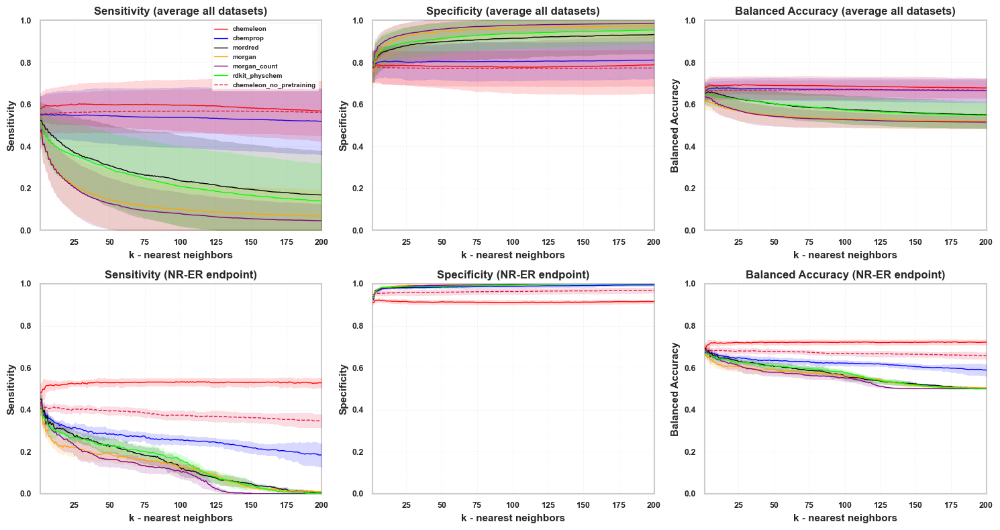

In [8]:
# Publication-ready figure: 2x3 grid
# Row 1: Average metrics across all datasets (Random split)
# Row 2: Metrics for nr-er endpoint (Random split)

# Set publication-ready style
plt.style.use('seaborn-v0_8-paper')
plt.rcParams.update({
    'font.size': 10,
    'font.family': 'sans-serif',
    'axes.labelsize': 11,
    'axes.titlesize': 12,
    'xtick.labelsize': 9,
    'ytick.labelsize': 9,
    'legend.fontsize': 8,
    'figure.titlesize': 14,
    'lines.linewidth': 2,
    'lines.markersize': 4,
    'grid.alpha': 0.3,
})

# Create figure with 2 rows and 3 columns
fig, axes = plt.subplots(2, 3, figsize=(15, 8))

# Metrics to plot
plot_metrics = ['sensitivity', 'specificity', 'balanced_accuracy']
metric_labels = ['Sensitivity', 'Specificity', 'Balanced Accuracy']

# Filter for Random split strategy
random_split = 'Random'

# Row 1: Average across all endpoints
for idx, (metric, label) in enumerate(zip(plot_metrics, metric_labels)):
    ax = axes[0, idx]

    # Filter data for random split
    subset = df[df['split_strategy'] == random_split]

    if not subset.empty:
        # Group by k and representation_type, calculate mean across all folds and endpoints
        grouped = subset.groupby(['k', 'representation_type'])[metric].agg(['mean', 'std']).reset_index()

        # Plot each representation type (plot chemeleon_no_pretraining last so it's on top)
        sorted_rep_types = [rt for rt in representation_types if rt != 'chemeleon_no_pretraining']
        if 'chemeleon_no_pretraining' in representation_types:
            sorted_rep_types.append('chemeleon_no_pretraining')

        for rep_type in sorted_rep_types:
            rep_data = grouped[grouped['representation_type'] == rep_type]

            # Apply k-value filter
            if K_FILTER == "even":
                rep_data = rep_data[rep_data["k"] % 2 == 0]
            elif K_FILTER == "odd":
                rep_data = rep_data[rep_data["k"] % 2 == 1]

            if not rep_data.empty:
                # Get configuration from rep_type_config
                color = get_rep_config(rep_type, 'color', '#000000')
                linestyle = get_rep_config(rep_type, 'linestyle', '-')
                linewidth_pub = get_rep_config(rep_type, 'linewidth_pub', 1.0)
                alpha_pub = get_rep_config(rep_type, 'alpha_pub', 0.15)
                zorder = get_rep_config(rep_type, 'zorder', 5)

                # Plot mean line
                ax.plot(rep_data['k'], rep_data['mean'],
                       label=rep_type,
                       color=color, linestyle=linestyle, linewidth=linewidth_pub, zorder=zorder)

                # Add shaded area for standard deviation
                ax.fill_between(rep_data['k'],
                               rep_data['mean'] - rep_data['std'],
                               rep_data['mean'] + rep_data['std'],
                               alpha=alpha_pub, color=color, zorder=zorder-1)

    ax.set_xlabel('k - nearest neighbors', fontsize=11)
    ax.set_ylabel(label, fontsize=11)
    ax.set_title(f'{label} (average all datasets)', fontsize=12, fontweight='bold')
    if idx == 0:  # Only show legend on the first subplot of the row
        ax.legend(fontsize=7, loc='upper right', framealpha=0.9)
    ax.grid(True, alpha=0.3, linestyle='--', linewidth=0.5)
    ax.set_xlim(k_min, k_max)
    # Set y-axis limits based on NORMALIZE_Y_AXIS flag
    if metric in metric_ranges:
        ax.set_ylim(metric_ranges[metric])

# Row 2: nr-er endpoint
endpoint_filter = 'nr_er'

for idx, (metric, label) in enumerate(zip(plot_metrics, metric_labels)):
    ax = axes[1, idx]

    # Filter data for random split and nr-er endpoint
    subset = df[(df['split_strategy'] == random_split) &
                (df['endpoint'] == endpoint_filter)]

    if not subset.empty:
        # Group by k and representation_type, calculate mean and std across folds
        grouped = subset.groupby(['k', 'representation_type'])[metric].agg(['mean', 'std']).reset_index()

        # Plot each representation type (plot chemeleon_no_pretraining last so it's on top)
        sorted_rep_types = [rt for rt in representation_types if rt != 'chemeleon_no_pretraining']
        if 'chemeleon_no_pretraining' in representation_types:
            sorted_rep_types.append('chemeleon_no_pretraining')

        for rep_type in sorted_rep_types:
            rep_data = grouped[grouped['representation_type'] == rep_type]

            # Apply k-value filter
            if K_FILTER == "even":
                rep_data = rep_data[rep_data["k"] % 2 == 0]
            elif K_FILTER == "odd":
                rep_data = rep_data[rep_data["k"] % 2 == 1]

            if not rep_data.empty:
                # Get configuration from rep_type_config
                color = get_rep_config(rep_type, 'color', '#000000')
                linestyle = get_rep_config(rep_type, 'linestyle', '-')
                linewidth_pub = get_rep_config(rep_type, 'linewidth_pub', 1.0)
                alpha_pub = get_rep_config(rep_type, 'alpha_pub', 0.15)
                zorder = get_rep_config(rep_type, 'zorder', 5)

                # Plot mean line
                ax.plot(rep_data['k'], rep_data['mean'],
                       label=rep_type,
                       color=color, linestyle=linestyle, linewidth=linewidth_pub, zorder=zorder)

                # Add shaded area for standard deviation
                ax.fill_between(rep_data['k'],
                               rep_data['mean'] - rep_data['std'],
                               rep_data['mean'] + rep_data['std'],
                               alpha=alpha_pub, color=color, zorder=zorder-1)

    ax.set_xlabel('k - nearest neighbors', fontsize=11)
    ax.set_ylabel(label, fontsize=11)
    ax.set_title(f'{label} (NR-ER endpoint)', fontsize=12, fontweight='bold')
    # if idx == 0:  # Only show legend on the first subplot of the row
    #     ax.legend(fontsize=7, loc='upper right', framealpha=0.9)
    ax.grid(True, alpha=0.3, linestyle='--', linewidth=0.5)
    ax.set_xlim(k_min, k_max)
    # Set y-axis limits based on NORMALIZE_Y_AXIS flag
    if metric in metric_ranges:
        ax.set_ylim(metric_ranges[metric])

# Adjust layout
plt.tight_layout()

# Save figure
pub_filename = f"publication_figure_random_split_comparison.png"
pub_filepath = output_dir / pub_filename
plt.savefig(pub_filepath, dpi=300, bbox_inches='tight', facecolor='white')
print(f"\nPublication figure saved: {pub_filepath}")

# Also save as PDF for publication
pub_pdf_filepath = output_dir / "publication_figure_random_split_comparison.pdf"
plt.savefig(pub_pdf_filepath, dpi=300, bbox_inches='tight', facecolor='white')
print(f"Publication figure (PDF) saved: {pub_pdf_filepath}")

plt.show()
plt.close()



Publication figure (Agglomerative Clustering) saved: data/final_data/knn_probing_plots/publication_figure_agglomerative_split_comparison.png
Publication figure (Agglomerative Clustering PDF) saved: data/final_data/knn_probing_plots/publication_figure_agglomerative_split_comparison.pdf


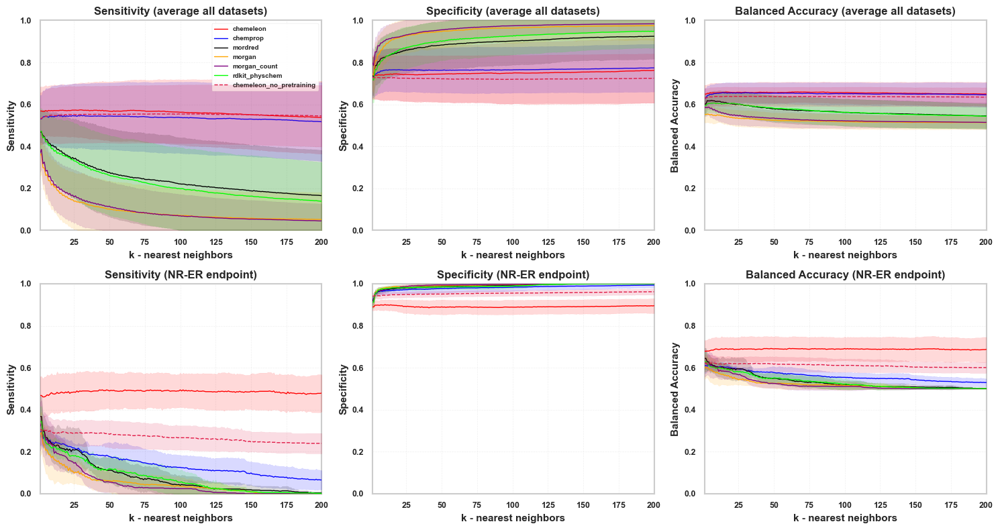

In [9]:
# Publication-ready figure: 2x3 grid for Agglomerative Clustering
# Row 1: Average metrics across all datasets (Agglomerative Clustering split)
# Row 2: Metrics for nr-er endpoint (Agglomerative Clustering split)

# Set publication-ready style
plt.style.use('seaborn-v0_8-paper')
plt.rcParams.update({
    'font.size': 10,
    'font.family': 'sans-serif',
    'axes.labelsize': 11,
    'axes.titlesize': 12,
    'xtick.labelsize': 9,
    'ytick.labelsize': 9,
    'legend.fontsize': 8,
    'figure.titlesize': 14,
    'lines.linewidth': 2,
    'lines.markersize': 4,
    'grid.alpha': 0.3,
})

# Create figure with 2 rows and 3 columns
fig, axes = plt.subplots(2, 3, figsize=(15, 8))

# Metrics to plot
plot_metrics = ['sensitivity', 'specificity', 'balanced_accuracy']
metric_labels = ['Sensitivity', 'Specificity', 'Balanced Accuracy']

# Filter for Agglomerative Clustering split strategy
agglomerative_split = 'Agglomerative clustering'

# Row 1: Average across all endpoints
for idx, (metric, label) in enumerate(zip(plot_metrics, metric_labels)):
    ax = axes[0, idx]

    # Filter data for agglomerative clustering split
    subset = df[df['split_strategy'] == agglomerative_split]

    if not subset.empty:
        # Group by k and representation_type, calculate mean across all folds and endpoints
        grouped = subset.groupby(['k', 'representation_type'])[metric].agg(['mean', 'std']).reset_index()

        # Plot each representation type (plot chemeleon_no_pretraining last so it's on top)
        sorted_rep_types = [rt for rt in representation_types if rt != 'chemeleon_no_pretraining']
        if 'chemeleon_no_pretraining' in representation_types:
            sorted_rep_types.append('chemeleon_no_pretraining')

        for rep_type in sorted_rep_types:
            rep_data = grouped[grouped['representation_type'] == rep_type]

            # Apply k-value filter
            if K_FILTER == "even":
                rep_data = rep_data[rep_data["k"] % 2 == 0]
            elif K_FILTER == "odd":
                rep_data = rep_data[rep_data["k"] % 2 == 1]

            if not rep_data.empty:
                # Get configuration from rep_type_config
                color = get_rep_config(rep_type, 'color', '#000000')
                linestyle = get_rep_config(rep_type, 'linestyle', '-')
                linewidth_pub = get_rep_config(rep_type, 'linewidth_pub', 1.0)
                alpha_pub = get_rep_config(rep_type, 'alpha_pub', 0.15)
                zorder = get_rep_config(rep_type, 'zorder', 5)

                # Plot mean line
                ax.plot(rep_data['k'], rep_data['mean'],
                       label=rep_type,
                       color=color, linestyle=linestyle, linewidth=linewidth_pub, zorder=zorder)

                # Add shaded area for standard deviation
                ax.fill_between(rep_data['k'],
                               rep_data['mean'] - rep_data['std'],
                               rep_data['mean'] + rep_data['std'],
                               alpha=alpha_pub, color=color, zorder=zorder-1)

    ax.set_xlabel('k - nearest neighbors', fontsize=11)
    ax.set_ylabel(label, fontsize=11)
    ax.set_title(f'{label} (average all datasets)', fontsize=12, fontweight='bold')
    if idx == 0:  # Only show legend on the first subplot of the row
        ax.legend(fontsize=7, loc='upper right', framealpha=0.9)
    ax.grid(True, alpha=0.3, linestyle='--', linewidth=0.5)
    ax.set_xlim(k_min, k_max)
    # Set y-axis limits based on NORMALIZE_Y_AXIS flag
    if metric in metric_ranges:
        ax.set_ylim(metric_ranges[metric])

# Row 2: nr-er endpoint
endpoint_filter = 'nr_er'

for idx, (metric, label) in enumerate(zip(plot_metrics, metric_labels)):
    ax = axes[1, idx]

    # Filter data for agglomerative clustering split and nr-er endpoint
    subset = df[(df['split_strategy'] == agglomerative_split) &
                (df['endpoint'] == endpoint_filter)]

    if not subset.empty:
        # Group by k and representation_type, calculate mean and std across folds
        grouped = subset.groupby(['k', 'representation_type'])[metric].agg(['mean', 'std']).reset_index()

        # Plot each representation type (plot chemeleon_no_pretraining last so it's on top)
        sorted_rep_types = [rt for rt in representation_types if rt != 'chemeleon_no_pretraining']
        if 'chemeleon_no_pretraining' in representation_types:
            sorted_rep_types.append('chemeleon_no_pretraining')

        for rep_type in sorted_rep_types:
            rep_data = grouped[grouped['representation_type'] == rep_type]

            # Apply k-value filter
            if K_FILTER == "even":
                rep_data = rep_data[rep_data["k"] % 2 == 0]
            elif K_FILTER == "odd":
                rep_data = rep_data[rep_data["k"] % 2 == 1]

            if not rep_data.empty:
                # Get configuration from rep_type_config
                color = get_rep_config(rep_type, 'color', '#000000')
                linestyle = get_rep_config(rep_type, 'linestyle', '-')
                linewidth_pub = get_rep_config(rep_type, 'linewidth_pub', 1.0)
                alpha_pub = get_rep_config(rep_type, 'alpha_pub', 0.15)
                zorder = get_rep_config(rep_type, 'zorder', 5)

                # Plot mean line
                ax.plot(rep_data['k'], rep_data['mean'],
                       label=rep_type,
                       color=color, linestyle=linestyle, linewidth=linewidth_pub, zorder=zorder)

                # Add shaded area for standard deviation
                ax.fill_between(rep_data['k'],
                               rep_data['mean'] - rep_data['std'],
                               rep_data['mean'] + rep_data['std'],
                               alpha=alpha_pub, color=color, zorder=zorder-1)

    ax.set_xlabel('k - nearest neighbors', fontsize=11)
    ax.set_ylabel(label, fontsize=11)
    ax.set_title(f'{label} (NR-ER endpoint)', fontsize=12, fontweight='bold')
    # No legend in row 2 to keep it clean
    ax.grid(True, alpha=0.3, linestyle='--', linewidth=0.5)
    ax.set_xlim(k_min, k_max)
    # Set y-axis limits based on NORMALIZE_Y_AXIS flag
    if metric in metric_ranges:
        ax.set_ylim(metric_ranges[metric])

# Adjust layout
plt.tight_layout()

# Save figure
pub_filename = f"publication_figure_agglomerative_split_comparison.png"
pub_filepath = output_dir / pub_filename
plt.savefig(pub_filepath, dpi=300, bbox_inches='tight', facecolor='white')
print(f"\nPublication figure (Agglomerative Clustering) saved: {pub_filepath}")

# Also save as PDF for publication
pub_pdf_filepath = output_dir / "publication_figure_agglomerative_split_comparison.pdf"
plt.savefig(pub_pdf_filepath, dpi=300, bbox_inches='tight', facecolor='white')
print(f"Publication figure (Agglomerative Clustering PDF) saved: {pub_pdf_filepath}")

plt.show()
plt.close()


Saved: data/final_data/knn_probing_plots/Agglomerative_clustering_AVERAGE.png


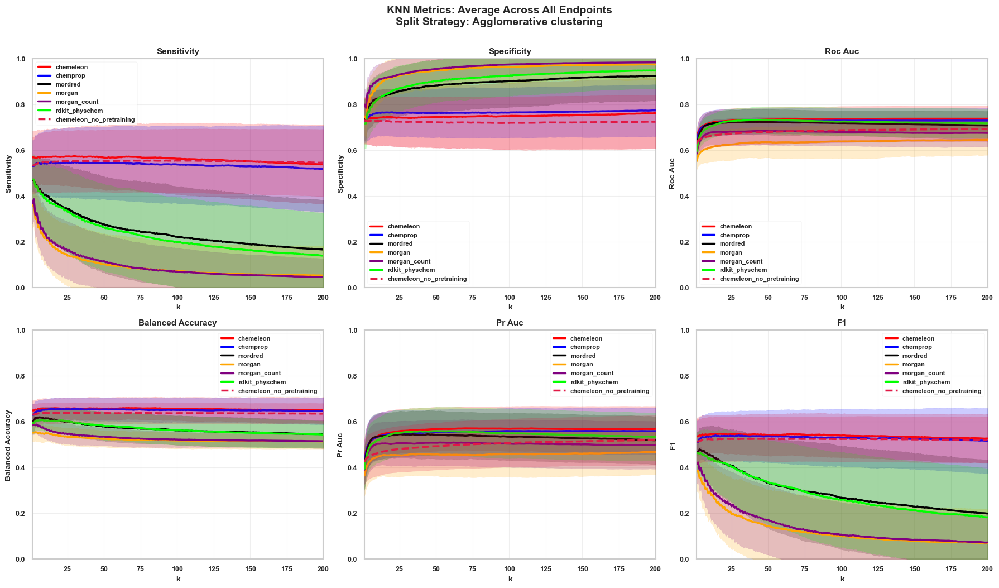

Saved: data/final_data/knn_probing_plots/Random_AVERAGE.png


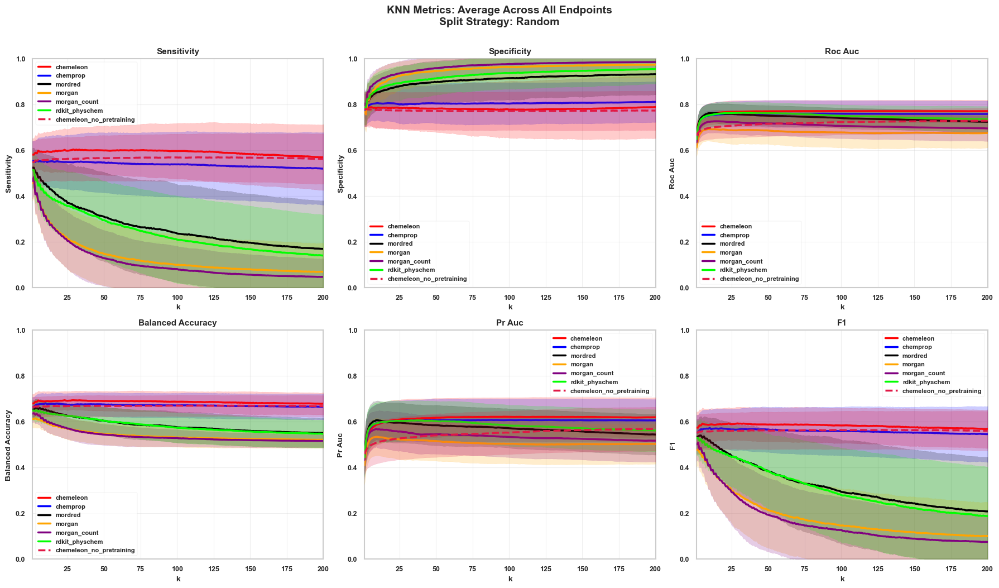


All summary plots saved to data/final_data/knn_probing_plots/


In [10]:
# Create summary plots: average across all endpoints for each split strategy
for split_strategy in split_strategies:
    fig, axes = plt.subplots(3, 3, figsize=(18, 15))
    axes = axes.flatten()

    for idx, metric in enumerate(metrics):
        ax = axes[idx]

        # Filter data for this split_strategy
        subset = df[df['split_strategy'] == split_strategy]

        if subset.empty:
            ax.set_title(f'{metric} (no data)')
            continue

        # Group by k and representation_type, calculate mean across folds and endpoints
        grouped = subset.groupby(['k', 'representation_type'])[metric].agg(['mean', 'std']).reset_index()

        # Plot each representation type (plot chemeleon_no_pretraining last so it's on top)
        sorted_rep_types = [rt for rt in representation_types if rt != 'chemeleon_no_pretraining']
        if 'chemeleon_no_pretraining' in representation_types:
            sorted_rep_types.append('chemeleon_no_pretraining')

        for rep_type in sorted_rep_types:
            rep_data = grouped[grouped['representation_type'] == rep_type]

            # Apply k-value filter
            if K_FILTER == "even":
                rep_data = rep_data[rep_data["k"] % 2 == 0]
            elif K_FILTER == "odd":
                rep_data = rep_data[rep_data["k"] % 2 == 1]
            # If "all", no filtering needed

            if not rep_data.empty:
                # Get configuration from rep_type_config
                color = get_rep_config(rep_type, 'color', '#000000')
                linestyle = get_rep_config(rep_type, 'linestyle', '-')
                linewidth = get_rep_config(rep_type, 'linewidth', 2.5)
                alpha = get_rep_config(rep_type, 'alpha', 0.2)
                zorder = get_rep_config(rep_type, 'zorder', 5)

                # Plot mean line
                ax.plot(rep_data['k'], rep_data['mean'],
                       label=rep_type, linewidth=linewidth,
                       color=color, linestyle=linestyle, zorder=zorder)

                # Add shaded area for standard deviation
                ax.fill_between(rep_data['k'],
                                rep_data['mean'] - rep_data['std'],
                                rep_data['mean'] + rep_data['std'],
                                alpha=alpha, color=color, zorder=zorder-1)

        ax.set_xlabel('k', fontsize=10)
        ax.set_ylabel(metric.replace('_', ' ').title(), fontsize=10)
        ax.set_title(f'{metric.replace("_", " ").title()}', fontsize=11, fontweight='bold')
        ax.legend(fontsize=8, loc='best')
        ax.grid(True, alpha=0.3)

        # Set consistent axis limits
        ax.set_xlim(k_min, k_max)
        ax.set_ylim(metric_ranges[metric])

    # Remove empty subplot
    if len(metrics) < len(axes):
        for idx in range(len(metrics), len(axes)):
            fig.delaxes(axes[idx])

    # Add overall title
    fig.suptitle(f'KNN Metrics: Average Across All Endpoints\nSplit Strategy: {split_strategy}',
                fontsize=14, fontweight='bold', y=0.995)

    plt.tight_layout(rect=[0, 0, 1, 0.99])

    # Save figure
    filename = f"{split_strategy.replace(' ', '_')}_AVERAGE.png"
    filepath = output_dir / filename
    plt.savefig(filepath, dpi=150, bbox_inches='tight')
    print(f"Saved: {filepath}")

    plt.show()
    plt.close()

print(f"\nAll summary plots saved to {output_dir}/")
